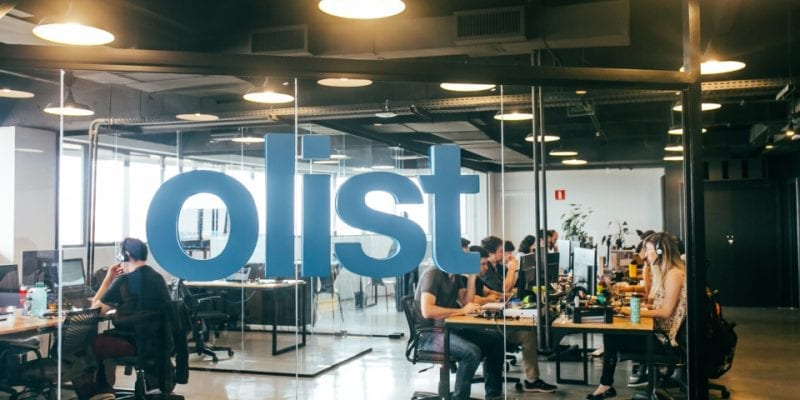

# Brazilian E-Commerce Olist Customers Segmentation

Vous êtes consultant pour Olist, une solution de vente sur les marketplaces en ligne.

Olist souhaite que vous fournissiez à ses équipes d'e-commerce une segmentation des clients qu’elles pourront utiliser au quotidien pour leurs campagnes de communication.

Votre objectif est de comprendre les différents types d’utilisateurs grâce à leur comportement et à leurs données personnelles.

Vous devrez fournir à l’équipe marketing une description actionable de votre segmentation et de sa logique sous-jacente pour une utilisation optimale, ainsi qu’une proposition de contrat de maintenance basée sur une analyse de la stabilité des segments au cours du temps.

Les données
Pour cette mission, Olist vous fournit une base de données anonymisée comportant des informations sur l’historique de commandes, les produits achetés, les commentaires de satisfaction, et la localisation des clients depuis janvier 2017.

Votre mission
Votre mission est d’aider les équipes d’Olist à comprendre les différents types d'utilisateurs. Vous utiliserez donc des méthodes non supervisées pour regrouper ensemble des clients de profils similaires. Ces catégories pourront être utilisées par l’équipe marketing pour mieux communiquer.

In [81]:
# ! usr/bin/env python 3
# coding: utf-8

# Importing librairies

import time
import warnings
import numpy as np               # numerical data processing
import pandas as pd              # numerical tables & time series
import scipy as sp
import scipy.stats as st         # statistical functions
import seaborn as sns            # statistical data visualization
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from sklearn.cluster import KMeans
from sklearn.utils import check_random_state

from sklearn import cluster, metrics
from sklearn.metrics import silhouette_samples
from sklearn.metrics import silhouette_score
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import calinski_harabasz_score

from sklearn.manifold import TSNE
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.base import clone
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA

from IPython.display import HTML
from pandas.plotting import parallel_coordinates
from kneed import KneeLocator
from yellowbrick.cluster import KElbowVisualizer,\
                                SilhouetteVisualizer,\
                                InterclusterDistance
from mpl_toolkits.mplot3d import Axes3D
# from functions import function

palette = sns.color_palette("bright", 10)
warnings.filterwarnings('ignore')

%load_ext pycodestyle_magic
%pycodestyle_on
# %reload_ext pycodestyle_magic

The pycodestyle_magic extension is already loaded. To reload it, use:
  %reload_ext pycodestyle_magic


In [82]:
# Transforming our input files.csv from the cleaning phase to dataframe

custom_order = pd.read_csv('custom_order.csv')
custom_order = custom_order.drop(['Unnamed: 0'], axis=1)
df_rfm = pd.read_csv('rfm.csv')

### Few functions to run in the notebook

In [83]:
def display_factorial_planes(X_projected, n_comp, pca, axis_ranks, labels=None, alpha=1, illustrative_var=None):
    '''Display a scatter plot on a factorial plane, one for each factorial plane'''

    # For each factorial plane
    for d1,d2 in axis_ranks:
        if d2 < n_comp:
 
            # Initialise the matplotlib figure      
            fig = plt.figure(figsize=(7,6))
        
            # Display the points
            if illustrative_var is None:
                plt.scatter(X_projected[:, d1], X_projected[:, d2], alpha=alpha)
            else:
                illustrative_var = np.array(illustrative_var)
                for value in np.unique(illustrative_var):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(X_projected[selected, d1], X_projected[selected, d2], alpha=alpha, label=value)
                plt.legend()

            # Display the labels on the points
            if labels is not None:
                for i,(x,y) in enumerate(X_projected[:,[d1,d2]]):
                    plt.text(x, y, labels[i],
                              fontsize='14', ha='center',va='center') 
                
            # Define the limits of the chart
            boundary = np.max(np.abs(X_projected[:, [d1,d2]])) * 1.1
            plt.xlim([-boundary,boundary])
            plt.ylim([-boundary,boundary])
        
            # Display grid lines
            plt.plot([-100, 100], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-100, 100], color='grey', ls='--')

            # Label the axes, with the percentage of variance explained
            plt.xlabel('PC{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('PC{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Projection of points (on PC{} and PC{})".format(d1+1, d2+1))
            #plt.show(block=False)

1:80: E501 line too long (112 > 79 characters)
2:80: E501 line too long (83 > 79 characters)
5:11: E231 missing whitespace after ','
7:1: W293 blank line contains whitespace
8:47: W291 trailing whitespace
9:40: E231 missing whitespace after ','
10:1: W293 blank line contains whitespace
13:80: E501 line too long (80 > 79 characters)
18:80: E501 line too long (111 > 79 characters)
23:22: E231 missing whitespace after ','
23:25: E231 missing whitespace after ','
23:55: E231 missing whitespace after ','
23:59: E231 missing whitespace after ','
25:31: E127 continuation line over-indented for visual indent
25:57: E231 missing whitespace after ','
25:70: W291 trailing whitespace
26:1: W293 blank line contains whitespace
28:56: E231 missing whitespace after ','
29:32: E231 missing whitespace after ','
30:32: E231 missing whitespace after ','
31:1: W293 blank line contains whitespace
37:80: E501 line too long (97 > 79 characters)
37:93: E231 missing whitespace after ','
38:80: E501 line too lon

In [84]:
def display_scree_plot(pca):
    '''Display a scree plot for the pca'''

    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
    plt.xlabel("Number of principal components")
    plt.ylabel("Percentage explained variance")
    plt.title("Scree plot")
    plt.show(block=False)

6:53: E231 missing whitespace after ','
6:61: E231 missing whitespace after ','


In [85]:
def addAlpha(colour, alpha):
    '''Add an alpha to the RGB colour'''
    return (colour[0], colour[1], colour[2], alpha)

In [86]:
def display_parallel_coordinates(df, num_clusters):
    '''Display a parallel coordinates plot for the clusters in df'''

    # Select data points for individual clusters
    cluster_points = []
    for i in range(num_clusters):
        cluster_points.append(df[df.cluster == i])

        # Create the plot
    fig = plt.figure(figsize=(12, 15))
    title = fig.suptitle("Parallel Coordinates Plot for the Clusters",
                         fontsize=18)
    fig.subplots_adjust(top=0.95, wspace=0)

    # Display one plot for each cluster, with the lines for the main cluster
    # appearing over the lines for the other clusters
    for i in range(num_clusters):
        plt.subplot(num_clusters, 1, i+1)
        for j, c in enumerate(cluster_points):
            if i != j:
                pc = parallel_coordinates(c, 'cluster',
                                          color=[addAlpha(palette[j], 0.2)])
        pc = parallel_coordinates(cluster_points[i], 'cluster',
                                  color=[addAlpha(palette[i], 0.5)])

        # Stagger the axes
        ax = plt.gca()
        for tick in ax.xaxis.get_major_ticks()[1::2]:
            tick.set_pad(20)

In [87]:
def display_parallel_coordinates_centroids(df, num_clusters):
    '''Display a parallel coordinates plot for the centroids in df'''

    # Create the plot
    fig = plt.figure(figsize=(12, 5))
    title = fig.suptitle("Parallel Coordinates plot for the Centroids", fontsize=18)
    fig.subplots_adjust(top=0.9, wspace=0)

    # Draw the chart
    parallel_coordinates(df, 'cluster', color=palette)

    # Stagger the axes
    ax=plt.gca()
    for tick in ax.xaxis.get_major_ticks()[1::2]:
        tick.set_pad(20)    

6:80: E501 line too long (84 > 79 characters)
13:7: E225 missing whitespace around operator
15:25: W291 trailing whitespace


In [88]:
def cluster_stability(X, est, n_iter=20, random_state=None):
    labels = []
    indices = []
    for i in range(n_iter):
        # draw bootstrap samples, store indices
        sample_indices = rng.randint(0, X.shape[0], X.shape[0])
        indices.append(sample_indices)
        est = clone(est)
        if hasattr(est, "random_state"):
            # randomize estimator if possible
            est.random_state = rng.randint(10)
        X_bootstrap = X[sample_indices]
        est.fit(X_bootstrap)
        # store clustering outcome using original indices
        relabel = -np.ones(X.shape[0], dtype=np.int)
        relabel[sample_indices] = est.labels_
        labels.append(relabel)
    scores = []
    for l, i in zip(labels, indices):
        for k, j in zip(labels, indices):
            # we also compute the diagonal which is a bit silly
            in_both = np.intersect1d(i, j)
            scores.append(adjusted_rand_score(l[in_both], k[in_both]))
    return np.mean(scores)

19:9: E741 ambiguous variable name 'l'


## 1. INPUT FILES OVERVIEW 

In [89]:
custom_order

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,order_item_id,product_id,seller_id,...,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name,total_spent,average_delivery_days,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,recency
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59,1,fd25ab760bfbba13c198fa3b4f1a0cd3,6d803cb79cc31c41c4c789a75933b3c7,...,11,3,Thu,198.63,6.0,68a5590b9926689be4e10f4ae2db21a8,6030,osasco,SP,229
1,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59,2,fd25ab760bfbba13c198fa3b4f1a0cd3,6d803cb79cc31c41c4c789a75933b3c7,...,11,3,Thu,198.63,6.0,68a5590b9926689be4e10f4ae2db21a8,6030,osasco,SP,229
2,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13,1,be0dbdc3d67d55727a65d4cd696ca73c,8e6d7754bc7e0f22c96d255ebda59eba,...,28,2,Wed,88.09,9.0,64190b91b656ab8f37eb89b93dc84584,13380,nova odessa,SP,182
3,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24,1,d1c427060a0f73f6b889a5c7c61f2ac4,a1043bafd471dff536d0c462352beb48,...,3,5,Sat,194.12,13.0,1d47144362c14e94ccdd213e8ec277d5,44571,santo antonio de jesus,BA,207
4,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06,1,52c80cedd4e90108bf4fa6a206ef6b03,a1043bafd471dff536d0c462352beb48,...,9,6,Sun,222.84,10.0,c8cf6cb6b838dc7a33ed199b825e8616,88735,gravatal,SC,506
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110008,574ed12dd733e5fa530cfd4bbf39d7c9,2a8c23fee101d4d5662fa670396eb8da,5,NaN,NaN,2018-07-07 00:00:00,2018-07-14 17:18:30,1,4fb209073dc2ab6a6d3c259a7c285501,5343d0649eca2a983820bfe93fc4d17e,...,27,2,Wed,287.97,8.0,50605c81f77a2171191dffee444613b2,74810,goiania,GO,62
110009,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42,1,3a33c980b62eb1ef3b8ae61b6fc6fe55,46dc3b2cc0980fb8ec44634e21d2718e,...,3,6,Sun,209.76,4.0,597cbb334f18a671472f7e16648228b4,22793,rio de janeiro,RJ,268
110010,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43,1,8ba0118a487ec8671aed57e5ef846574,17ca9b9e9b9ef8fdb529001b49ebb50f,...,18,6,Sun,231.56,3.0,c860357db400d72a2497064f8376fba9,37200,lavras,MG,164
110011,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13,1,73a7fbf8c1048131f3b531af31bcdf0e,8d956fec2e4337affcb520f56fd8cbfd,...,22,4,Fri,66.41,7.0,96ac4cb74918d3ace141d3d3ddc1ff02,32667,betim,MG,67


In [90]:
df_rfm

,customer_id,recency,monetary,frequency
0,00012a2ce6f8dcda20d059ce98491703,287,114.74,1
1,000161a058600d5901f007fab4c27140,409,67.41,1
2,0001fd6190edaaf884bcaf3d49edf079,547,195.42,1
3,0002414f95344307404f0ace7a26f1d5,378,179.35,1
4,000379cdec625522490c315e70c7a9fb,149,107.01,1
...,...,...,...,...
95826,fffcb937e9dd47a13f05ecb8290f4d3e,165,91.91,1
95827,fffecc9f79fd8c764f843e9951b11341,152,81.36,1
95828,fffeda5b6d849fbd39689bb92087f431,99,63.13,1
95829,ffff42319e9b2d713724ae527742af25,76,214.13,1


## 1. Classic RFM Clustering

### 1.1 Data pre-processing

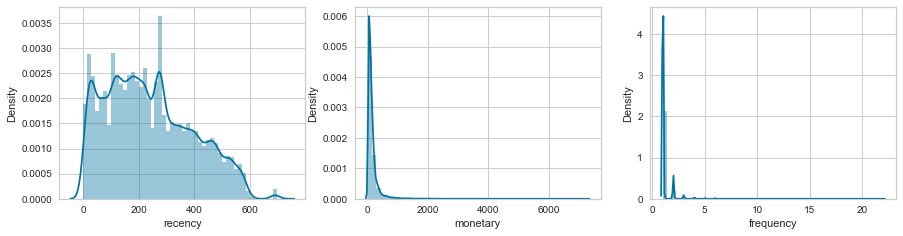

In [91]:
fig = plt.figure(figsize=(15, 12))

ax = fig.add_subplot(331)
sns.distplot(df_rfm['recency'], ax=ax)

ax = fig.add_subplot(332)
sns.distplot(df_rfm['monetary'], ax=ax)

ax = fig.add_subplot(333)
sns.distplot(df_rfm['frequency'], ax=ax)
plt.show()

### Transformation of our key variables into log scale

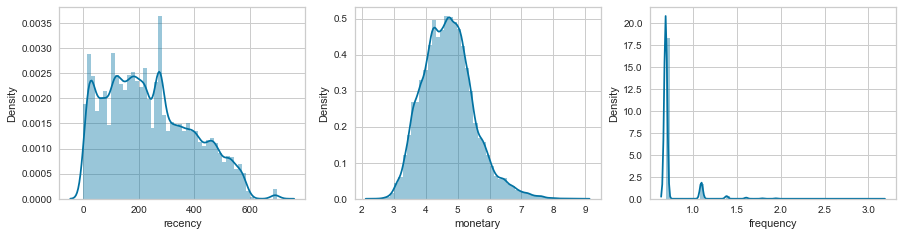

3:19: E231 missing whitespace after ','
3:54: E231 missing whitespace after ','
3:80: E501 line too long (83 > 79 characters)
4:11: E225 missing whitespace around operator


In [92]:
fig = plt.figure(figsize=(15, 12))
df_rfm = df_rfm.set_index('customer_id')
df_rfm[["monetary","frequency"]] = df_rfm[["monetary","frequency"]].apply(np.log1p)
df_rfm_log=df_rfm.copy()

ax = fig.add_subplot(331)
sns.distplot(df_rfm_log['recency'], ax=ax)

ax = fig.add_subplot(332)
sns.distplot(df_rfm_log['monetary'], ax=ax)

ax = fig.add_subplot(333)
sns.distplot(df_rfm_log['frequency'], ax=ax)
plt.show()

In [93]:
df_rfm_log.describe()

,recency,monetary,frequency
count,95831.000000,95831.000000,95831.000000
mean,238.969947,4.705597,0.745993
std,152.862599,0.800020,0.170241
min,0.000000,2.359910,0.693147
25%,115.000000,4.143293,0.693147
50%,220.000000,4.667018,0.693147
75%,349.000000,5.181109,0.693147
max,713.000000,8.892320,3.135494


KMeans is very sensitive to scale and requires all features to be on the same scale. KMeans will put more weight or emphasis on features with larger variances and those features will impose more influence on the final cluster shape.

In [94]:
# Standardization of data for the linear scale
scaler = StandardScaler()
scaler.fit(df_rfm_log)
df_rfm_log.describe()

,recency,monetary,frequency
count,95831.000000,95831.000000,95831.000000
mean,238.969947,4.705597,0.745993
std,152.862599,0.800020,0.170241
min,0.000000,2.359910,0.693147
25%,115.000000,4.143293,0.693147
50%,220.000000,4.667018,0.693147
75%,349.000000,5.181109,0.693147
max,713.000000,8.892320,3.135494


In [95]:
# Standardization of data for the logarithmic scale
rfm_log_scaled = scaler.transform(df_rfm_log)
rfm_log_scaled = pd.DataFrame(rfm_log_scaled, columns=df_rfm_log.columns)
round(rfm_log_scaled.describe(), 2)

,recency,monetary,frequency
count,95831.00,95831.00,95831.00
mean,0.00,0.00,0.00
std,1.00,1.00,1.00
min,-1.56,-2.93,-0.31
25%,-0.81,-0.70,-0.31
50%,-0.12,-0.05,-0.31
75%,0.72,0.59,-0.31
max,3.10,5.23,14.04


### 2.1 K-Means Clustering

The k-means clustering method is an unsupervised machine learning technique used to identify clusters of data objects in a dataset. K-means requires only a few steps. The first step is to randomly select k centroids, where k is equal to the number of clusters you choose. Centroids are data points representing the center of a cluster.

The main element of the algorithm works by a two-step process called expectation-maximization. The expectation step assigns each data point to its nearest centroid. Then, the maximization step computes the mean of all the points for each cluster and sets the new centroid.

In [96]:
X = df_rfm_log.copy()
X_scaled = rfm_log_scaled.copy()

In [97]:
X_scaled.describe()

,recency,monetary,frequency
count,9.583100e+04,9.583100e+04,9.583100e+04
mean,4.579973e-16,4.650028e-16,2.713596e-15
std,1.000005e+00,1.000005e+00,1.000005e+00
min,-1.563307e+00,-2.932050e+00,-3.104186e-01
25%,-8.109936e-01,-7.028651e-01,-3.104186e-01
50%,-1.240987e-01,-4.822295e-02,-3.104186e-01
75%,7.198008e-01,5.943787e-01,-3.104186e-01
max,3.101037e+00,5.233300e+00,1.403607e+01


#### 2D Visualization of the normalized raw data

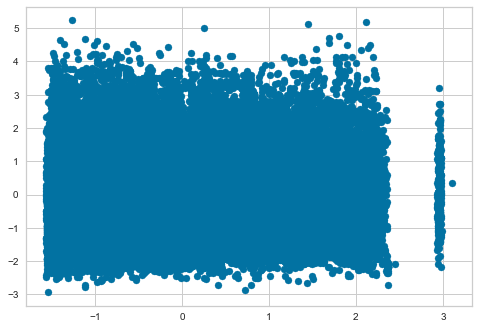

In [98]:
plt.scatter(X_scaled.iloc[:, 0], X_scaled.iloc[:, 1], c='b')
plt.show()

#### 3D Visualization of the raw data

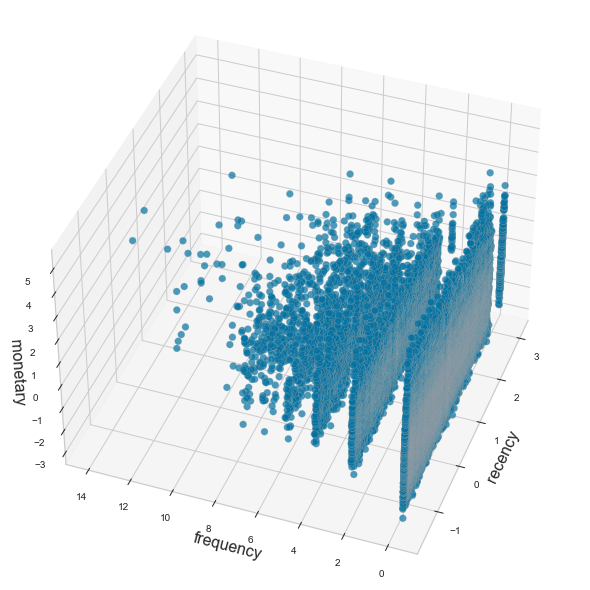

In [99]:
plt.rcParams['figure.figsize'] = (10, 8)
fig = plt.figure(1)
plt.clf()
ax = Axes3D(fig,
            rect=[0, 0, 1, 1],
            elev=40,
            azim=200)

plt.cla()
ax.scatter(X_scaled['recency'], X_scaled['frequency'], X_scaled['monetary'],
           # c=rfm_norm['cluster'],
           s=50,
           cmap='spring',
           alpha=0.7,
           edgecolor='darkgrey')

ax.set_xlabel('recency', fontsize=16)
ax.set_ylabel('frequency', fontsize=16)
ax.set_zlabel('monetary', fontsize=16)

plt.show()

### Selecting the number of clusters with silhouette analysis on KMeans clustering

Silhouette score for a set of sample data points is used to measure how dense and well-separated the clusters are.
Silhouette score takes into consideration the intra-cluster distance between the sample and other data points within the same cluster (a) and inter-cluster distance between the sample and the next nearest cluster (b).
The silhouette score falls within the range [-1, 1].

The silhouette score of 1 means that the clusters are very dense and nicely separated. The score of 0 means that clusters are overlapping. The score of less than 0 means that data belonging to clusters may be wrong/incorrect.
The silhouette plots can be used to select the most optimal value of the K (no. of cluster) in K-means clustering.
The aspects to look out for in Silhouette plots are cluster scores below the average silhouette score, wide fluctuations in the size of the clusters, and also the thickness of the silhouette plot.

### Methods to estimate optimal number of clusters

__The Elbow method__ runs k-means clustering on the dataset for a range of values for k (here 2 to 10) and then for each value of k computes an average score for all clusters. By default, the distortion score is computed, the sum of square errors (sse) from each point to its assigned center. When we analyze the graph we can see that the graph will rapidly change at a point and thus creating an elbow shape. From this point, the graph starts to move almost parallel to the X-axis. The K value corresponding to this point is the optimal K value or an optimal number of clusters.

__The Davies-Bouldin score__ is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Thus, clusters which are farther apart and less dispersed will result in a better score.
The minimum score is zero, with lower values indicating better clustering.

__Calinski-Harabasz (CH) Index__ (introduced by Calinski and Harabasz in 1974) can be used to evaluate the model when ground truth labels are not known where the validation of how well the clustering has been done is made using quantities and features inherent to the dataset. 
Higher value of CH index means the clusters are dense and well separated, although there is no “acceptable” cut-off value. We need to choose that solution which gives a peak or at least an abrupt elbow on the line plot of CH indices. On the other hand, if the line is smooth (horizontal or ascending or descending) then there is no such reason to prefer one solution over others. 

In [102]:
# Conservation des résultats sous forme de dictionnarie
metrics = {"sse": sse,
           "db": db,
           "ch": ch,
           "slc": slc}

In [103]:
def cluster_selection(range_n_clusters, metrics):
    """
    Display 4 plots: Elbow method, Davies-Bouldin Index
    Calinski-Harabsz & Silhouette score
    vs number of clusters

    Parameters:
    metrics: Dict of metrics results
    range_n_clusters: Number of clusters observed
    """

    fig, axs = plt.subplots(2, 2, figsize=(20, 10))
    fig.suptitle("Selection of optimal number of clusters",
                 fontsize=18, weight='bold', size=20)

    # Display inertia v clusters number
    axs[0, 0].plot(range_n_clusters, metrics["sse"])
    axs[0, 0].set_title('Elbow graph', weight='bold', size=14)
    axs[0, 0].set(xlabel='Clusters number', ylabel='Inertia')

    # Display of Davies-Bouldin index v clusters number
    axs[0, 1].plot(range_n_clusters, metrics["db"])
    axs[0, 1].set_title("Davies-Bouldin Index", weight='bold', size=14)
    axs[0, 1].set(xlabel='Clusters number', ylabel='Davies-Bouldin Index')

    # Display of Calinski-Harabasz index v clusters number
    # plt.subplot(132)
    axs[1, 0].plot(range_n_clusters, metrics["ch"])
    axs[1, 0].set_title("Calinski-Harabasz Index", weight='bold', size=14)
    axs[1, 0].set(xlabel='Clusters number', ylabel='Calinski-Harabasz Index')

    # Display silhouette score v clusters number
    axs[1, 1].plot(range_n_clusters, metrics["slc"])
    axs[1, 1].set_title("Silhouette profile", weight='bold', size=14)
    axs[1, 1].set(xlabel="Clusters number", ylabel="Silhouette Score")

    plt.show()

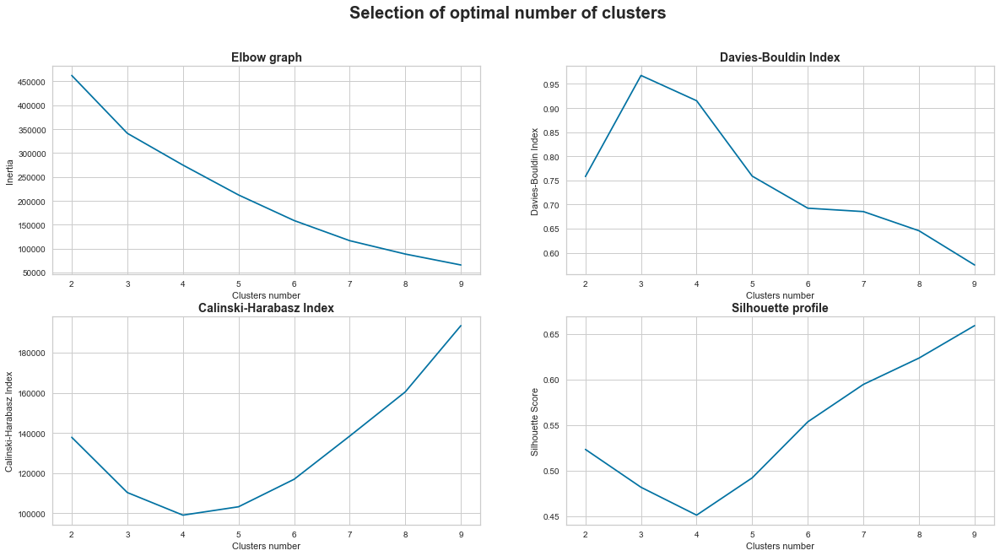

In [104]:
range_n_clusters = range(2, 10)
cluster_selection(range_n_clusters, metrics)

In [105]:
def stability_init(X, range_n_clusters, n_iters=10):
    """
    Measure cluster initialization stability through ARI
    (Adjusted Rand Index)

    Parameters:
    X - Input data
    range_n_clusters - Number of clusters observed
    n_iters - Number of iteration for the clustering
    """

    ARI = {}
    ARI_mean, ARI_std = {}, {}
    rfm_table = pd.DataFrame()
    for n_clusters in range_n_clusters:
        kmeans = KMeans(n_clusters=n_clusters,
                        init='k-means++',
                        random_state=1000)

        clusters = kmeans.fit_predict(X)
        rfm_table['n_clusters_' + str(n_clusters)] = clusters
        ARI[n_clusters] = []

        for n_it in range(n_iters):
            km = KMeans(n_clusters=n_clusters,
                        init='k-means++',
                        random_state=n_it)
            clusters = km.fit_predict(X)
            ARI[n_clusters].append(
                adjusted_rand_score(rfm_table['n_clusters_' + str(n_clusters)],
                                    clusters))
        ARI_std[n_clusters] = np.std(ARI[n_clusters])
        ARI_mean[n_clusters] = np.mean(ARI[n_clusters])
    return ARI_mean, ARI_std

In [106]:
# Measure of the initialization stability
ARI_mean, ARI_std = stability_init(X_scaled, range_n_clusters)

In [107]:
# Conservation des résultats dans le dictionnaire
metrics["ARI_mean"] = ARI_mean
metrics["ARI_std"] = ARI_std

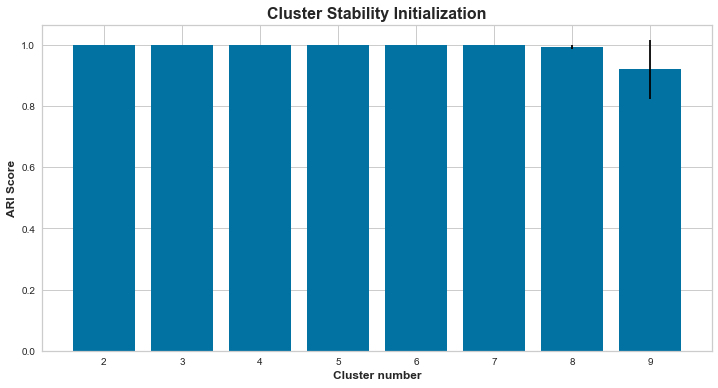

In [80]:
fig, ax = plt.subplots(figsize=(12, 6))
# ARI Score on n_itérations
plt.bar(range_n_clusters, height=metrics["ARI_mean"].values())
plt.errorbar(range_n_clusters,
             metrics["ARI_mean"].values(),
             yerr=metrics["ARI_std"].values(),
             fmt='none', ecolor='black')

plt.title("Cluster Stability Initialization",
          fontsize=18, weight='bold', size=16)
plt.xlabel('Cluster number', weight='bold', size='12')
plt.ylabel('ARI Score', weight='bold', size='12')

plt.show()

In [85]:
# Apply KMeans with optimal K
kmean = KMeans(n_clusters=6, init='k-means++', random_state=42)

clusters = kmean.fit_predict(X_scaled)
X['pred_cluster'] = clusters

# Clusters centers
centres = kmean.cluster_centers_

In [103]:
X_scaled.head(50)

,recency,monetary,frequency,clusters
0,0.524025,0.057186,-0.310419,0
1,0.897294,-0.600085,-0.310419,0
2,1.203900,0.718309,-0.310419,6
3,0.814205,0.611616,-0.310419,6
4,-0.165373,-0.029216,-0.310419,0
5,1.117539,-0.522341,-0.310419,0
6,0.027310,-0.981987,-0.310419,0
7,0.395412,0.519894,-0.310419,6
8,0.717930,-0.310717,-0.310419,0
9,-2.348995,3.038259,-0.310419,5


In [102]:
X_scaled.iloc[:, 0]

0        0.524025
1        0.897294
2        1.203900
3        0.814205
4       -0.165373
           ...   
95826   -0.058261
95827   -0.144445
95828   -0.593881
95829   -0.870100
95830    0.765705
Name: recency, Length: 95831, dtype: float64

In [108]:
# Plot KMeans Results (2 dim)
sns.scatterplot(data= X, x=X_scaled.iloc[:, 0],
                y=X_scaled.iloc[:, 1], hue='pred_cluster',
                palette='viridis')
# plt.scatter(centres[:, 0], centres[:, 1],
#             marker='x', s=169, linewidths=3,
#             color='k', zorder=10)
plt.show()

ValueError: Could not interpret value `pred_cluster` for parameter `hue`

2:22: E251 unexpected spaces around keyword / parameter equals


## 2. Enhanced RFM Clustering

In [116]:
# We create a new feature: the total number of items purchased by a customer
custom_order['total_items'] = custom_order.groupby(['customer_id'])\
                            ['order_item_id'].transform(max)
custom_order = custom_order[custom_order['order_item_id'] ==
                            custom_order['total_items']]
custom_order

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,order_item_id,product_id,seller_id,...,order_purchase_dayofweek,order_purchase_dayofweek_name,total_spent,average_delivery_days,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,recency,total_items
1,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59,2,fd25ab760bfbba13c198fa3b4f1a0cd3,6d803cb79cc31c41c4c789a75933b3c7,...,3,Thu,198.63,6.0,68a5590b9926689be4e10f4ae2db21a8,6030,osasco,SP,229,2
2,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13,1,be0dbdc3d67d55727a65d4cd696ca73c,8e6d7754bc7e0f22c96d255ebda59eba,...,2,Wed,88.09,9.0,64190b91b656ab8f37eb89b93dc84584,13380,nova odessa,SP,182,1
3,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24,1,d1c427060a0f73f6b889a5c7c61f2ac4,a1043bafd471dff536d0c462352beb48,...,5,Sat,194.12,13.0,1d47144362c14e94ccdd213e8ec277d5,44571,santo antonio de jesus,BA,207,1
4,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06,1,52c80cedd4e90108bf4fa6a206ef6b03,a1043bafd471dff536d0c462352beb48,...,6,Sun,222.84,10.0,c8cf6cb6b838dc7a33ed199b825e8616,88735,gravatal,SC,506,1
5,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53,1,3880d25d502b15b1de6fddc42ad1d67a,989becdce12ebc39863c2bceab6f3ca1,...,5,Sat,1333.25,18.0,d16000272660a1fef81482ad75ba572a,89520,curitibanos,SC,200,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110008,574ed12dd733e5fa530cfd4bbf39d7c9,2a8c23fee101d4d5662fa670396eb8da,5,NaN,NaN,2018-07-07 00:00:00,2018-07-14 17:18:30,1,4fb209073dc2ab6a6d3c259a7c285501,5343d0649eca2a983820bfe93fc4d17e,...,2,Wed,287.97,8.0,50605c81f77a2171191dffee444613b2,74810,goiania,GO,62,1
110009,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42,1,3a33c980b62eb1ef3b8ae61b6fc6fe55,46dc3b2cc0980fb8ec44634e21d2718e,...,6,Sun,209.76,4.0,597cbb334f18a671472f7e16648228b4,22793,rio de janeiro,RJ,268,1
110010,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43,1,8ba0118a487ec8671aed57e5ef846574,17ca9b9e9b9ef8fdb529001b49ebb50f,...,6,Sun,231.56,3.0,c860357db400d72a2497064f8376fba9,37200,lavras,MG,164,1
110011,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13,1,73a7fbf8c1048131f3b531af31bcdf0e,8d956fec2e4337affcb520f56fd8cbfd,...,4,Fri,66.41,7.0,96ac4cb74918d3ace141d3d3ddc1ff02,32667,betim,MG,67,1


2:68: E211 whitespace before '['


Let's add 2 new features to our original RFM table and the one we created above.

In [117]:
delivery = custom_order.groupby("customer_id")["average_delivery_days"].mean()

In [118]:
review = custom_order.groupby("customer_id")["review_score"].mean()
review.shape

(95832,)

In [119]:
nbr_items = custom_order.groupby("customer_id")['total_items'].max()
nbr_items.shape

(95832,)

In [120]:
df_rfm = pd.merge(pd.merge(pd.merge(df_rfm, 
                           delivery, on='customer_id'),
                           review, on='customer_id'),
                           nbr_items, on='customer_id')
df_rfm.rename(columns={"average_delivery_days": "delivery"}, inplace=True)
df_rfm.rename(columns={"review": "review_score"}, inplace=True)
df_rfm.to_csv('extr.csv')
df_rfm

,recency,monetary,frequency,delivery,review_score,total_items
customer_id,,,,,,
00012a2ce6f8dcda20d059ce98491703,287,4.751346,0.693147,13.0,1.0,1
000161a058600d5901f007fab4c27140,409,4.225519,0.693147,9.0,4.0,1
0001fd6190edaaf884bcaf3d49edf079,547,5.280255,0.693147,5.0,5.0,1
0002414f95344307404f0ace7a26f1d5,378,5.194899,0.693147,28.0,5.0,1
000379cdec625522490c315e70c7a9fb,149,4.682224,0.693147,11.0,4.0,1
...,...,...,...,...,...,...
fffcb937e9dd47a13f05ecb8290f4d3e,165,4.531631,0.693147,4.0,5.0,1
fffecc9f79fd8c764f843e9951b11341,152,4.411100,0.693147,12.0,3.0,1
fffeda5b6d849fbd39689bb92087f431,99,4.160912,0.693147,17.0,4.0,1


1:44: W291 trailing whitespace
4:28: E127 continuation line over-indented for visual indent


In [121]:
df_rfm.describe()

,recency,monetary,frequency,delivery,review_score,total_items
count,95831.000000,95831.000000,95831.000000,95823.000000,95831.000000,95831.000000
mean,238.969947,4.705597,0.745993,12.052211,4.156219,1.141196
std,152.862599,0.800020,0.170241,9.466076,1.283588,0.533628
min,0.000000,2.359910,0.693147,0.000000,1.000000,1.000000
25%,115.000000,4.143293,0.693147,6.000000,4.000000,1.000000
50%,220.000000,4.667018,0.693147,10.000000,5.000000,1.000000
75%,349.000000,5.181109,0.693147,15.000000,5.000000,1.000000
max,713.000000,8.892320,3.135494,208.000000,5.000000,21.000000


In [123]:
# df_rfm.dropna()
df_rfm = df_rfm[(df_rfm['delivery'] !=0)]
df_rfm.dropna(subset = ["delivery"], inplace=True)
# df_rfm = df_rfm.set_index('customer_id')
df_rfm.describe()

,recency,monetary,frequency,delivery,review_score,total_items
count,95810.000000,95810.000000,95810.000000,95810.000000,95810.000000,95810.000000
mean,238.973113,4.705569,0.745991,12.053846,4.156181,1.141175
std,152.857878,0.800024,0.170214,9.465677,1.283593,0.533452
min,0.000000,2.359910,0.693147,1.000000,1.000000,1.000000
25%,115.000000,4.143293,0.693147,6.000000,4.000000,1.000000
50%,220.000000,4.667018,0.693147,10.000000,5.000000,1.000000
75%,349.000000,5.181109,0.693147,15.000000,5.000000,1.000000
max,713.000000,8.892320,3.135494,208.000000,5.000000,21.000000


2:39: E225 missing whitespace around operator
3:21: E251 unexpected spaces around keyword / parameter equals
3:23: E251 unexpected spaces around keyword / parameter equals


In [124]:
rfm_norm = preprocessing.scale(df_rfm)
rfm_norm = pd.DataFrame(data=rfm_norm,
                        columns=["recency", "monetary",
                                 "frequency", "delivery",
                                 "review_score", 'total_items'])
rfm_norm.describe()

,recency,monetary,frequency,delivery,review_score,total_items
count,9.581000e+04,9.581000e+04,9.581000e+04,9.581000e+04,9.581000e+04,9.581000e+04
mean,-8.037616e-17,-7.366801e-17,-9.565555e-16,3.569933e-16,3.162248e-15,6.980975e-16
std,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00
min,-1.563376e+00,-2.932001e+00,-3.104594e-01,-1.167788e+00,-2.458876e+00,-2.646461e-01
25%,-8.110394e-01,-7.028271e-01,-3.104594e-01,-6.395610e-01,-1.216752e-01,-2.646461e-01
50%,-1.241232e-01,-4.818826e-02,-3.104594e-01,-2.169794e-01,6.573919e-01,-2.646461e-01
75%,7.198024e-01,5.944102e-01,-3.104594e-01,3.112476e-01,6.573919e-01,-2.646461e-01
max,3.101112e+00,5.233308e+00,1.403832e+01,2.070081e+01,6.573919e-01,3.722721e+01


### Distribution of variables

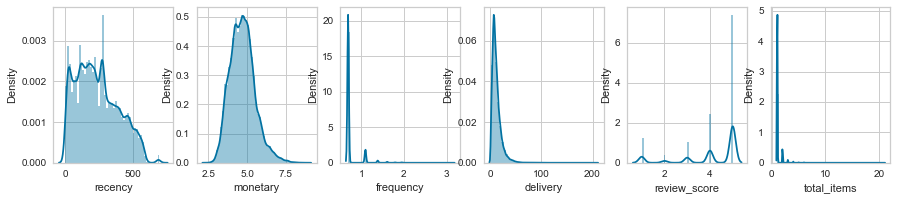

In [125]:
fig = plt.figure(figsize=(15, 20))

ax = fig.add_subplot(661)
sns.distplot(df_rfm['recency'], ax=ax)

ax = fig.add_subplot(662)
sns.distplot(df_rfm['monetary'], ax=ax)

ax = fig.add_subplot(663)
sns.distplot(df_rfm['frequency'], ax=ax)

ax = fig.add_subplot(664)
sns.distplot(df_rfm['delivery'], ax=ax)

ax = fig.add_subplot(665)
sns.distplot(df_rfm['review_score'], ax=ax)

ax = fig.add_subplot(666)
sns.distplot(df_rfm['total_items'], ax=ax)

plt.show()

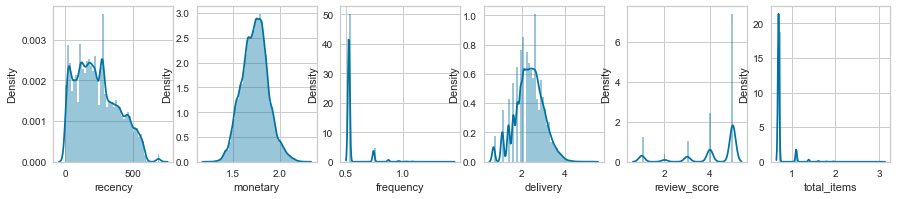

2:19: E231 missing whitespace after ','
3:1: E122 continuation line missing indentation or outdented
3:19: E231 missing whitespace after ','
4:11: E225 missing whitespace around operator


In [126]:
fig = plt.figure(figsize=(15, 20))
df_rfm[["monetary","frequency", "delivery", 'total_items']] =\
df_rfm[["monetary","frequency", "delivery", 'total_items']].apply(np.log1p)
df_rfm_log=df_rfm.copy()
ax = fig.add_subplot(661)
sns.distplot(df_rfm_log['recency'], ax=ax)

ax = fig.add_subplot(662)
sns.distplot(df_rfm_log['monetary'], ax=ax)

ax = fig.add_subplot(663)
sns.distplot(df_rfm_log['frequency'], ax=ax)

ax = fig.add_subplot(664)
sns.distplot(df_rfm_log['delivery'], ax=ax)

ax = fig.add_subplot(665)
sns.distplot(df_rfm_log['review_score'], ax=ax)

ax = fig.add_subplot(666)
sns.distplot(df_rfm_log['total_items'], ax=ax)
plt.show()

In [127]:
df_rfm_log.describe()

,recency,monetary,frequency,delivery,review_score,total_items
count,95810.000000,95810.000000,95810.000000,95810.000000,95810.000000,95810.000000
mean,238.973113,1.731805,0.553443,2.368247,4.156181,0.743663
std,152.857878,0.138484,0.083873,0.636150,1.283593,0.166628
min,0.000000,1.211914,0.526589,0.693147,1.000000,0.693147
25%,115.000000,1.637694,0.526589,1.945910,4.000000,0.693147
50%,220.000000,1.734663,0.526589,2.397895,5.000000,0.693147
75%,349.000000,1.821498,0.526589,2.772589,5.000000,0.693147
max,713.000000,2.291759,1.419607,5.342334,5.000000,3.091042


KMeans is very sensitive to scale and requires all features to be on the same scale. KMeans will put more weight or emphasis on features with larger variances and those features will impose more influence on the final cluster shape.

In [128]:
# Standardization of data for the linear scale
scaler = StandardScaler()
scaler.fit(df_rfm_log)
df_rfm_log.describe()

,recency,monetary,frequency,delivery,review_score,total_items
count,95810.000000,95810.000000,95810.000000,95810.000000,95810.000000,95810.000000
mean,238.973113,1.731805,0.553443,2.368247,4.156181,0.743663
std,152.857878,0.138484,0.083873,0.636150,1.283593,0.166628
min,0.000000,1.211914,0.526589,0.693147,1.000000,0.693147
25%,115.000000,1.637694,0.526589,1.945910,4.000000,0.693147
50%,220.000000,1.734663,0.526589,2.397895,5.000000,0.693147
75%,349.000000,1.821498,0.526589,2.772589,5.000000,0.693147
max,713.000000,2.291759,1.419607,5.342334,5.000000,3.091042


In [129]:
# Standardization of data for the logarithmic scale
rfm_log_scaled = scaler.transform(df_rfm_log)
rfm_log_scaled = pd.DataFrame(rfm_log_scaled, columns=df_rfm_log.columns)
round(rfm_log_scaled.describe(), 2)

,recency,monetary,frequency,delivery,review_score,total_items
count,95810.00,95810.00,95810.00,95810.00,95810.00,95810.00
mean,-0.00,-0.00,-0.00,0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00
min,-1.56,-3.75,-0.32,-2.63,-2.46,-0.30
25%,-0.81,-0.68,-0.32,-0.66,-0.12,-0.30
50%,-0.12,0.02,-0.32,0.05,0.66,-0.30
75%,0.72,0.65,-0.32,0.64,0.66,-0.30
max,3.10,4.04,10.33,4.68,0.66,14.09


### 2.1 K-Means Clustering

The k-means clustering method is an unsupervised machine learning technique used to identify clusters of data objects in a dataset. K-means requires only a few steps. The first step is to randomly select k centroids, where k is equal to the number of clusters you choose. Centroids are data points representing the center of a cluster.

The main element of the algorithm works by a two-step process called expectation-maximization. The expectation step assigns each data point to its nearest centroid. Then, the maximization step computes the mean of all the points for each cluster and sets the new centroid.

In [130]:
X=df_rfm_log.copy()
X_scaled=rfm_log_scaled.copy()

1:2: E225 missing whitespace around operator
2:9: E225 missing whitespace around operator


### PCA before K-Means

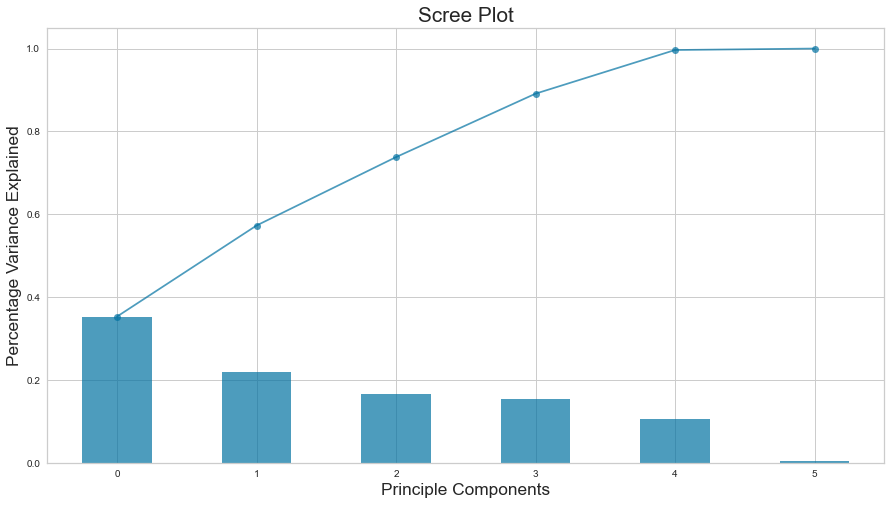

5:23: E231 missing whitespace after ','
6:51: W291 trailing whitespace
7:36: E261 at least two spaces before inline comment
16:46: E261 at least two spaces before inline comment
16:47: E262 inline comment should start with '# '
16:80: E501 line too long (86 > 79 characters)
20:11: E703 statement ends with a semicolon


In [131]:
pca = PCA()
pca.fit(X_scaled)

sns.color_palette("icefire_r", as_cmap=True)
plt.figure(figsize=(15,8))
exp_var = pd.Series(pca.explained_variance_ratio_) 
exp_var.plot(kind="bar", alpha=0.7) # plot bar chart

# Calculate the amount of variance explained added by each additional component
total = 0
var_ls = []
for x in exp_var:
    total = total+x
    var_ls.append(total)

pd.Series(var_ls).plot(marker="o", alpha=0.7) #plot line chart of increasing variances
plt.xlabel("Principle Components", fontsize="x-large")
plt.ylabel("Percentage Variance Explained", fontsize="x-large")
plt.title("Scree Plot", fontsize="xx-large")
plt.show();

In [132]:
# create PCA with 3 components
pca = PCA(n_components=3)
X_reduced = pca.fit_transform(X_scaled)

X_reduceddf = pd.DataFrame(X_reduced, index=X_scaled.index, columns=['PC1','PC2', 'PC3'])
X_reduceddf

,PC1,PC2,PC3
0,0.115520,1.854162,-0.675843
1,-0.551278,0.325866,1.016948
2,-0.350460,-0.124981,1.952512
3,-0.238527,1.296373,0.818857
4,-0.371868,0.117729,-0.647988
...,...,...,...
95805,-0.657691,-1.302102,-0.169336
95806,-0.320846,0.564266,-0.856519
95807,-0.539142,0.336611,-0.873140
95808,-0.347059,-1.074985,-0.878015


5:75: E231 missing whitespace after ','
5:80: E501 line too long (89 > 79 characters)


Plot our samples on a scatter plot in the new factorial planes.

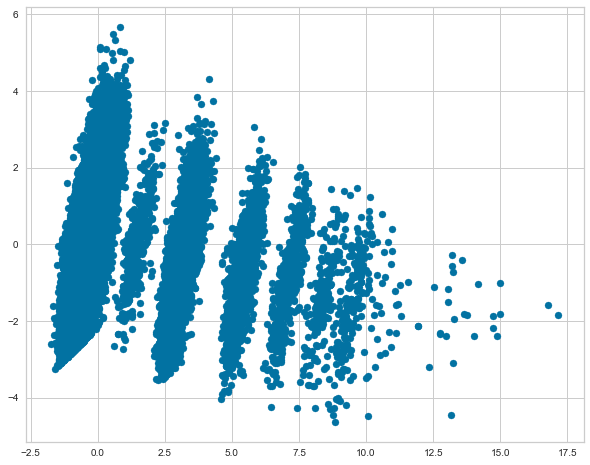

In [133]:
plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c='b')
plt.show()

### 3D Display

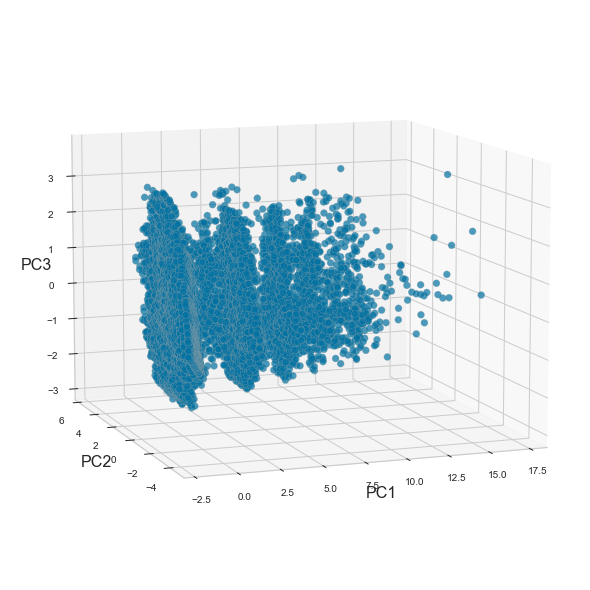

In [134]:
plt.rcParams['figure.figsize'] = (10, 8)
fig = plt.figure(1)
plt.clf()
ax = Axes3D(fig,
            rect=[0, 0, 1, 1],
            elev=10,
            azim=250)

plt.cla()
ax.scatter(X_reduceddf['PC1'], X_reduceddf['PC2'], X_reduceddf['PC3'],
           # c=rfm_norm['cluster'],
           s=50,
           cmap='spring',
           alpha=0.7,
           edgecolor='darkgrey')

ax.set_xlabel('PC1', fontsize=16)
ax.set_ylabel('PC2', fontsize=16)
ax.set_zlabel('PC3', fontsize=16)

plt.show()

In [135]:
def silhouette_profile(df, range_n_clusters):
    """
    Cette fonction teste pour différents nombre de clusters,
    un clustering des données par la méthode k-means.
    La fonction affiche le score de silhouette pour chacun des clusters,
    ainsi que la répartition des données dans l'espace RFM
    et leurs codes couleurs associés en fonction de leur appartenance
    aux différents clusters déterminés.

    Parametres:
    rfm (pd.DataFrame): DataFrame avec 3 colonnes nommés :
    Recency, Frequency and Monetary

    Return :
    list: Liste des valeurs d'intertie pour différents nombre de clusters
    """

   # Liste des valeurs d'inertie
    wcss = []
    # Temps d'entrainement
    fit_predict_time = []
    # Score de silhouette
    silhouette_score_avg = []

    palette = sns.color_palette("tab10", max(range_n_clusters))
    colors = palette.as_hex()

    df_ = df.copy()

    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig = plt.figure(1, figsize=(18, 7))
        ax1 = fig.add_subplot(121)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example
        # all lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(df) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, init='k-means++',
                           random_state=10)
        start_time = time.time()
        cluster_labels = clusterer.fit_predict(df)
        time.time() - start_time

        fit_predict_time.append(time.time() - start_time)
        wcss.append(clusterer.inertia_)
        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation
        # of the formed clusters
        silhouette_score_avg.append(silhouette_score(df, cluster_labels))

        # Compute the silhouette scores for each sample
        sample_silh_values = silhouette_samples(df, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silh_values = sample_silh_values[cluster_labels == i]

            ith_cluster_silh_values.sort()

            size_cluster_i = ith_cluster_silh_values.shape[0]
            y_upper = y_lower + size_cluster_i

            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0,
                              ith_cluster_silh_values,
                              facecolor=colors[i],
                              edgecolor=colors[i],
                              alpha=0.7)

            # Label the silhouette plots with
            # their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_score_avg[-1], color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        dx = fig.add_subplot(122, projection='3d')

        df_["clusters"] = cluster_labels
        for i in range(n_clusters):
            dx.scatter(df_[df_.clusters == i].PC1,
                       df_[df_.clusters == i].PC2,
                       df_[df_.clusters == i].PC3,
                       c=colors[i],
                       label='Cluster ' + str(i+1),
                       s=50)

            # Labeling the clusters
            centers = clusterer.cluster_centers_
            # Draw white circles at cluster centers
            dx.scatter(centers[:, 0],
                       centers[:, 1],
                       centers[:, 2],
                       marker='o',
                       c="white",
                       alpha=1,
                       s=200,
                       edgecolor='k')

            for i, c in enumerate(centers):
                dx.scatter(c[0],
                           c[1],
                           c[2],
                           marker='$%d$' % i,
                           alpha=1,
                           s=50,
                           edgecolor='k')
        # Titres des axes
        dx.set_xlabel("PC1")
        dx.set_ylabel("PC2")
        dx.set_zlabel("PC3")

        plt.suptitle(("Silhouette analysis for k-means clustering "
                      "on sample data with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

        plt.show()

18:4: E114 indentation is not a multiple of four (comment)


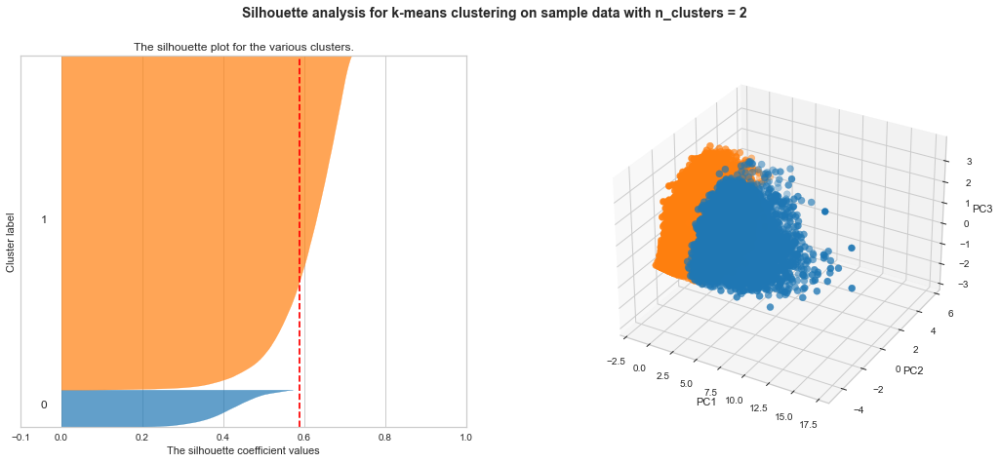

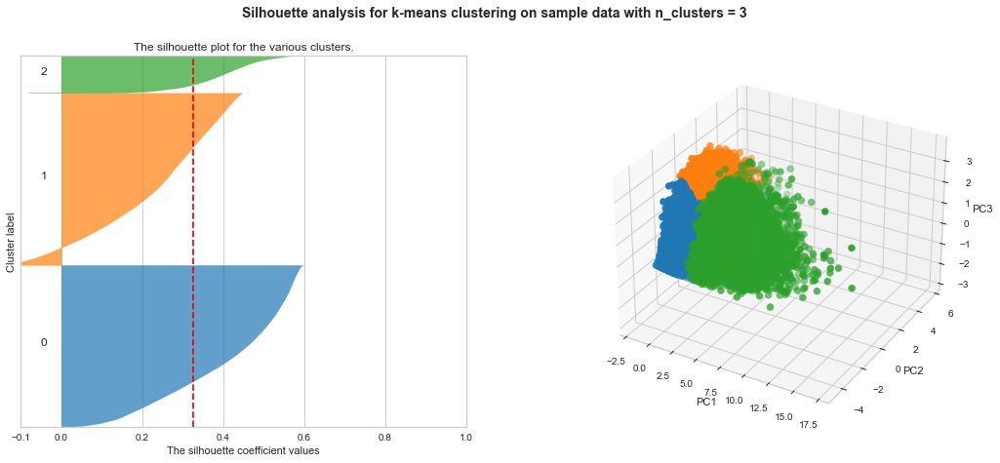

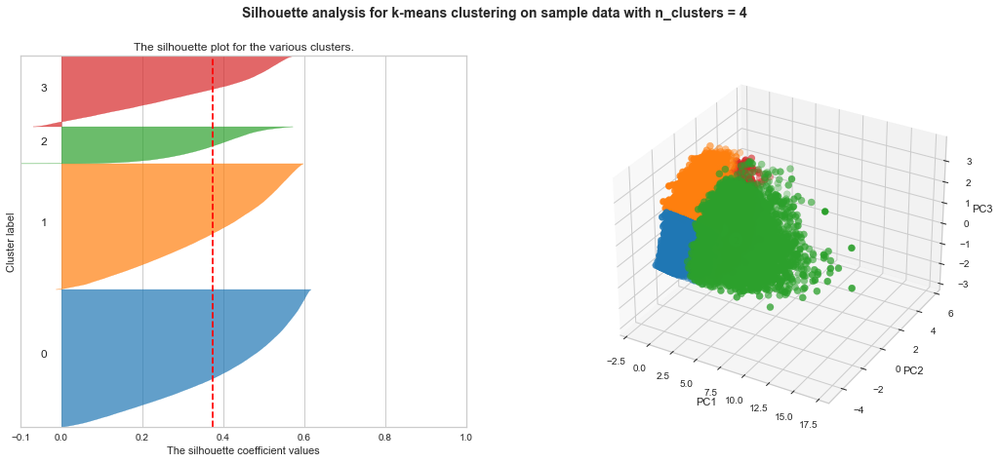

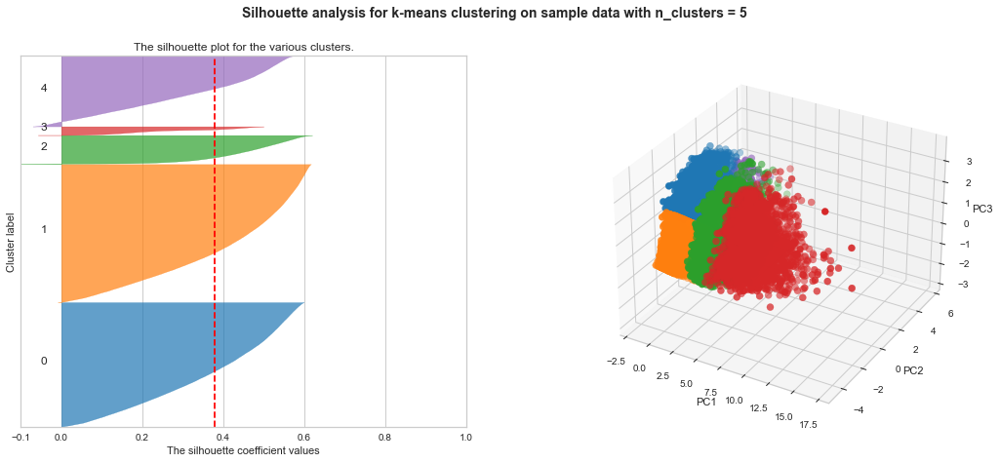

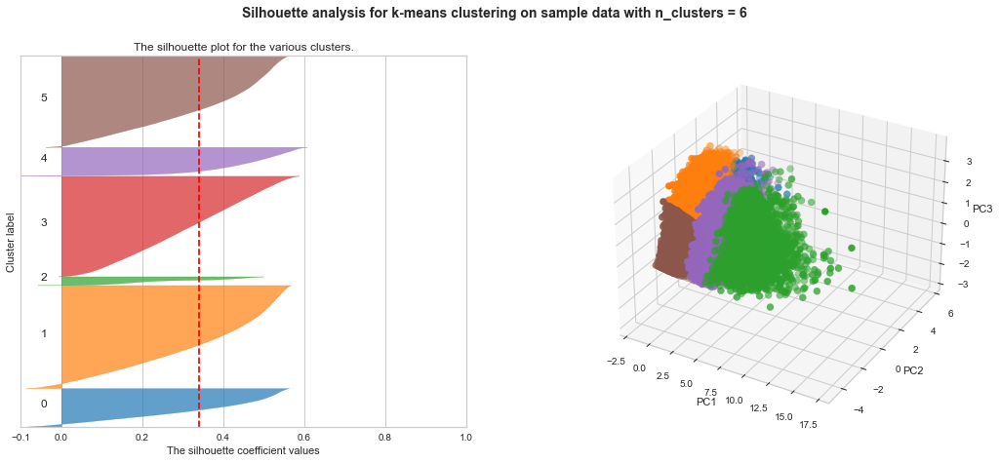

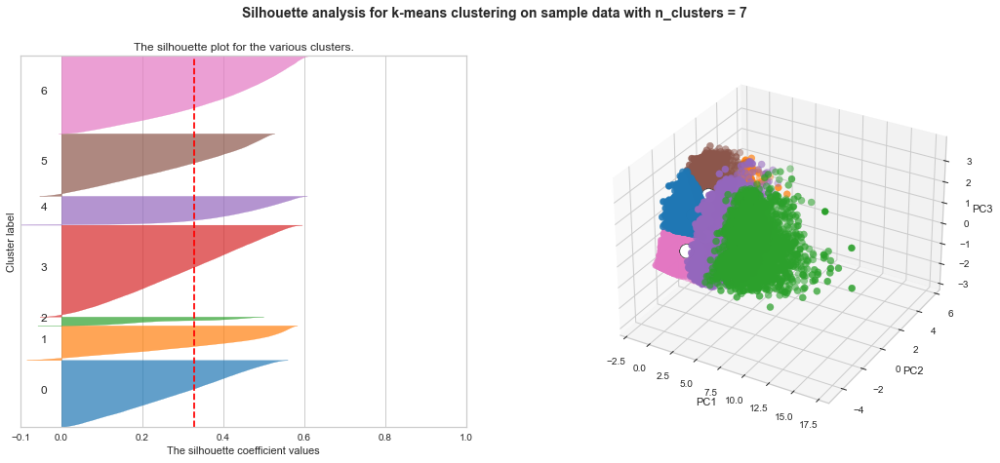

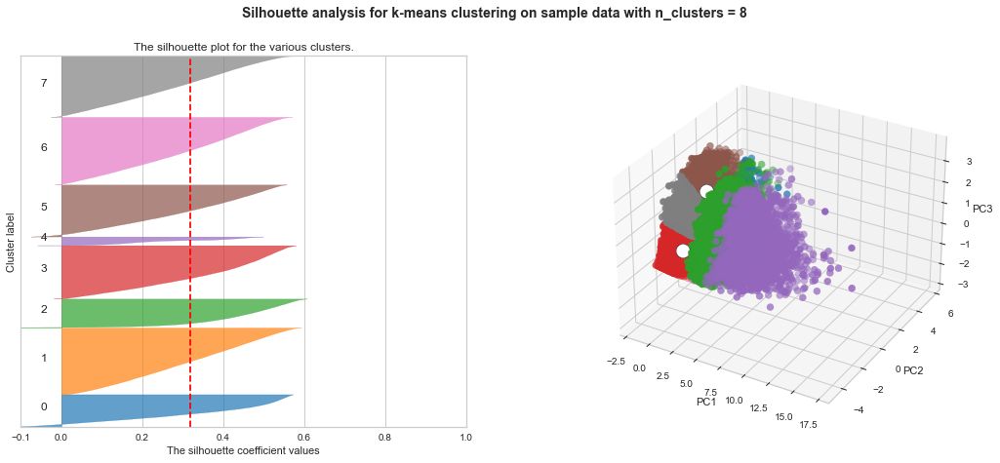

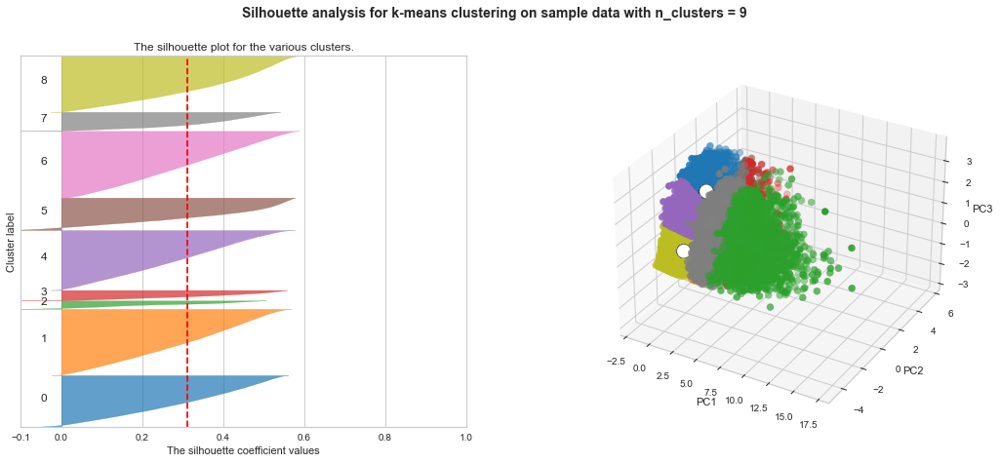

5:21: W291 trailing whitespace


In [136]:
# Résultats kmeans pour différents nombre de clusters
range_n_clusters = range(3, 9)
# wcss,
# silhouette_score_avg,
# fit_predict_time = 
silhouette_profile(X_reduceddf, range_n_clusters)

Silhouette score for a set of sample data points is used to measure how dense and well-separated the clusters are.
Silhouette score takes into consideration the intra-cluster distance between the sample and other data points within the same cluster (a) and inter-cluster distance between the sample and the next nearest cluster (b).
The silhouette score falls within the range [-1, 1].

The silhouette score of 1 means that the clusters are very dense and nicely separated. The score of 0 means that clusters are overlapping. The score of less than 0 means that data belonging to clusters may be wrong/incorrect.
The silhouette plots can be used to select the most optimal value of the K (no. of cluster) in K-means clustering.
The aspects to look out for in Silhouette plots are cluster scores below the average silhouette score, wide fluctuations in the size of the clusters, and also the thickness of the silhouette plot.

### Different metrics can be calculated

__The Elbow method__ runs k-means clustering on the dataset for a range of values for k (here 2 to 10) and then for each value of k computes an average score for all clusters. By default, the distortion score is computed, the sum of square errors (ssd) from each point to its assigned center.

__The Davies-Bouldin score__ is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Thus, clusters which are farther apart and less dispersed will result in a better score.
The minimum score is zero, with lower values indicating better clustering.

__Calinski-Harabasz (CH) Index__ (introduced by Calinski and Harabasz in 1974) can be used to evaluate the model when ground truth labels are not known where the validation of how well the clustering has been done is made using quantities and features inherent to the dataset. 
Higher value of CH index means the clusters are dense and well separated, although there is no “acceptable” cut-off value. We need to choose that solution which gives a peak or at least an abrupt elbow on the line plot of CH indices. On the other hand, if the line is smooth (horizontal or ascending or descending) then there is no such reason to prefer one solution over others. 



In [137]:
sse, db, ch, slc = [], [], [], []  # distorsion score
for k in range(3, 9):
    kmeans = KMeans(n_clusters=k, max_iter=50, random_state=10)
    start_time = time.time()
    kmeans.fit(X_scaled)
    cluster_labels = kmeans.labels_
    time.time() - start_time

    # Elbow method
    sse.append(kmeans.inertia_)

    # Davies-Bouldin index
    db_avg = davies_bouldin_score(X_scaled, cluster_labels)
    db.append(db_avg)

    # Calinski-Harabasz
    ch_avg = calinski_harabasz_score(X_scaled, cluster_labels)
    ch.append(ch_avg)

    # Silhouette profile
    silhouette_avg = silhouette_score(X_scaled, cluster_labels)
    slc.append(silhouette_avg)

    # Training time
    # tt.append(time.time() - start_time)

In [138]:
# Creation of a dict to keep the different metrics
metrics = {"sse": sse,
           "db": db,
           "ch": ch,
           "slc": slc}

In [139]:
def cluster_selection(range_n_clusters, metrics):
    """
    Display 4 plots: Elbow method, Davies-Bouldin Index
    Calinski-Harabsz & Silhouette score
    vs number of clusters

    Parameters:
    metrics: Dict of metrics results
    range_n_clusters: Number of clusters observed
    """

    fig, axs = plt.subplots(2, 2, figsize=(20, 10))
    fig.suptitle("Selection of optimal number of clusters",
                 fontsize=18, weight='bold', size=20)

    # Display inertia v clusters number
    axs[0, 0].plot(range_n_clusters, metrics["sse"])
    axs[0, 0].set_title('Elbow graph', weight='bold', size=14)
    axs[0, 0].set(xlabel='Clusters number', ylabel='Inertia')

    # Display of Davies-Bouldin index v clusters number
    axs[0, 1].plot(range_n_clusters, metrics["db"])
    axs[0, 1].set_title("Davies-Bouldin Index", weight='bold', size=14)
    axs[0, 1].set(xlabel='Clusters number', ylabel='Davies-Bouldin Index')

    # Display of Calinski-Harabasz index v clusters number
    # plt.subplot(132)
    axs[1, 0].plot(range_n_clusters, metrics["ch"])
    axs[1, 0].set_title("Calinski-Harabasz Index", weight='bold', size=14)
    axs[1, 0].set(xlabel='Clusters number', ylabel='Calinski-Harabasz Index')

    # Display silhouette score v clusters number
    axs[1, 1].plot(range_n_clusters, metrics["slc"])
    axs[1, 1].set_title("Silhouette profile", weight='bold', size=14)
    axs[1, 1].set(xlabel="Clusters number", ylabel="Silhouette Score")

    plt.show()

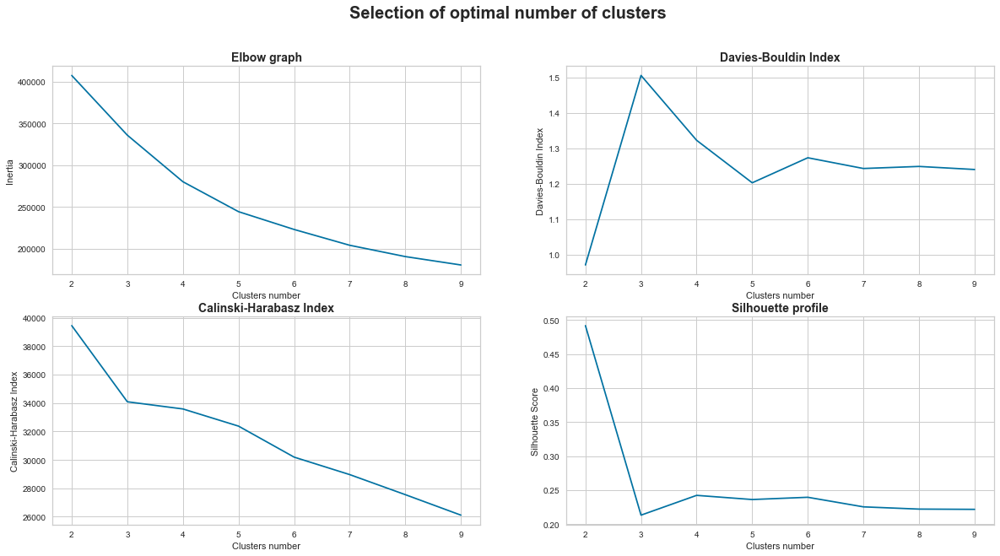

In [140]:
range_n_clusters = range(2, 10)
cluster_selection(range_n_clusters, metrics)

In [141]:
def stability_init(X, range_n_clusters, n_iters=10):
    """
    Measure cluster initialization stability through ARI
    (Adjusted Rand Index)

    Parameters:
    X - Input data
    range_n_clusters - Number of clusters observed
    n_iters - Number of iteration for the clustering
    """

    ARI = {}
    ARI_mean, ARI_std = {}, {}
    rfm_table = pd.DataFrame()
    for n_clusters in range_n_clusters:
        kmeans = KMeans(n_clusters=n_clusters,
                        init='k-means++',
                        random_state=1000)

        clusters = kmeans.fit_predict(X)
        rfm_table['n_clusters_' + str(n_clusters)] = clusters
        ARI[n_clusters] = []

        for n_it in range(n_iters):
            km = KMeans(n_clusters=n_clusters,
                        init='k-means++',
                        random_state=n_it)
            clusters = km.fit_predict(X)
            ARI[n_clusters].append(
                adjusted_rand_score(rfm_table['n_clusters_' + str(n_clusters)],
                                    clusters))
        ARI_std[n_clusters] = np.std(ARI[n_clusters])
        ARI_mean[n_clusters] = np.mean(ARI[n_clusters])
    return ARI_mean, ARI_std

In [142]:
# Measure of the initialization stability
ARI_mean, ARI_std = stability_init(X_reduceddf, range_n_clusters)

In [143]:
# Conservation des résultats dans le dictionnaire
metrics["ARI_mean"] = ARI_mean
metrics["ARI_std"] = ARI_std

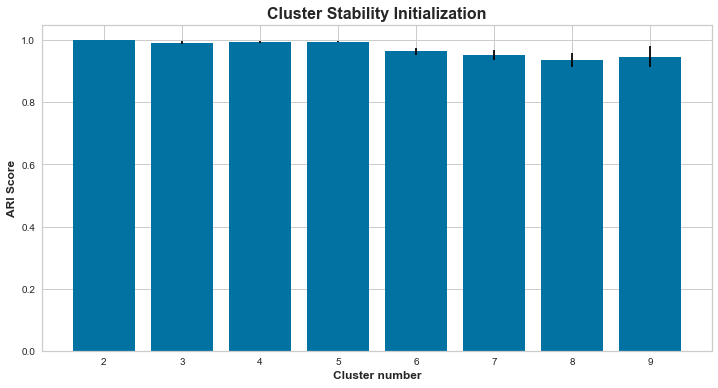

In [144]:
fig, ax = plt.subplots(figsize=(12, 6))
# ARI Score on n_itérations
plt.bar(range_n_clusters, height=metrics["ARI_mean"].values())
plt.errorbar(range_n_clusters,
             metrics["ARI_mean"].values(),
             yerr=metrics["ARI_std"].values(),
             fmt='none', ecolor='black')

plt.title("Cluster Stability Initialization",
          fontsize=18, weight='bold', size=16)
plt.xlabel('Cluster number', weight='bold', size='12')
plt.ylabel('ARI Score', weight='bold', size='12')

plt.show()

The Rand Index computes a similarity measure between two clusterings by considering all pairs of samples and counting pairs that are assigned in the same or different clusters in the predicted and true clusterings.

The raw RI score is then “adjusted for chance” into the ARI score using the following scheme:

ARI = (RI - Expected_RI) / (max(RI) - Expected_RI)<br>

The adjusted Rand index is thus ensured to have a value close to 0.0 for random labeling independently of the number of clusters and samples and exactly 1.0 when the clusterings are identical (up to a permutation).

As seen on the bar chart above, clusters initialization stability is excellent until 5 clusters and strart decreasing slowly with a bigger number of clusters.

In [181]:
# Apply KMeans with optimum K
kmeans = KMeans(n_clusters=5, init='k-means++', random_state=42)

clusters = kmeans.fit_predict(X_reduced)
X['pred_cluster'] = clusters

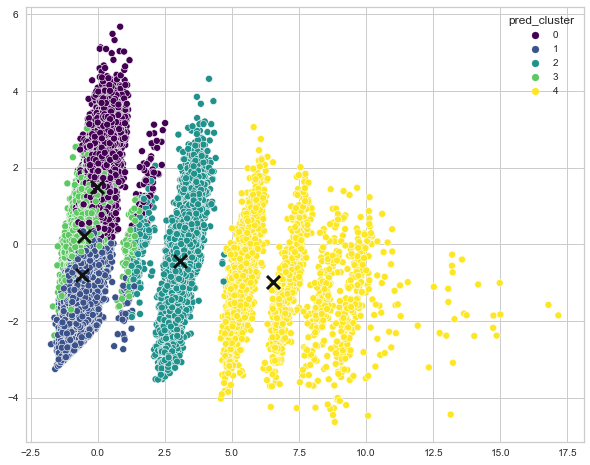

In [182]:
# Plot KMeans Results (2 dim)
sns.scatterplot(data=X, x=X_reduced[:, 0],
                y=X_reduced[:, 1], hue='pred_cluster',
                palette='viridis')
plt.scatter(centres_reduced[:, 0], centres_reduced[:, 1],
            marker='x', s=169, linewidths=3,
            color='k', zorder=10)
plt.show()

In [183]:
# 3d Scatter plot of clusters using K-means
import plotly.express as px
# %pycodestyle_off
fig = px.scatter_3d(X_reduced, x= X_reduced[:,0],
                    y= X_reduced[:,1], z=X_reduced[:, 2],
                    color=X['pred_cluster'],
                    labels={'x':'Feature 1', 'y':'Feature 2', 'z': 'Feature 3'} )
fig.update_traces(marker=dict(size=4,
                              line=dict(width=2,
                                        color='DarkSlateGrey'), colorscale='Viridis'),
                  selector=dict(mode='markers'))
fig.show()

### Parallel Coordinates Plot

We can use a parallel coordinates plot to see how individual data points sit across all our variables. In the following chart, each color represents a different cluster. By looking at how the values for the variables compare across the clusters we can get a feel for what the clusters actually represent.

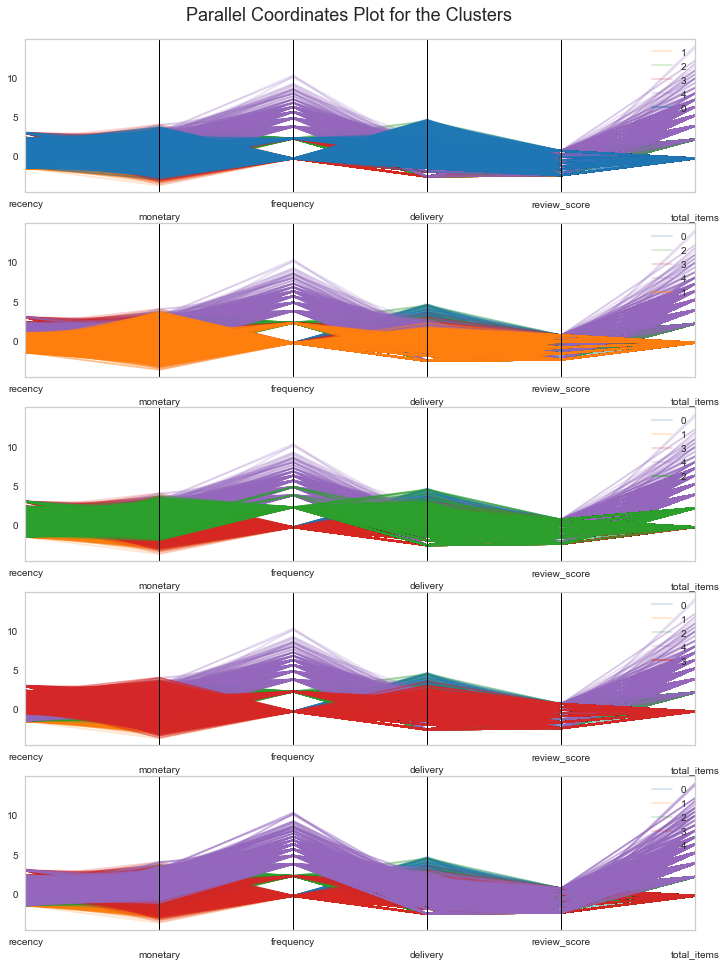

In [172]:
# Add the cluster number to the original scaled data
#X_clustered = pd.DataFrame(X_scaled, index=X.index, columns=X.columns)
X_clustered = X_scaled.copy()
X_clustered["cluster"] = clusters
X_clustered.drop('pred_cluster', axis=1, inplace=True)
X_clustered
# Display parallel coordinates plots, one for each cluster
display_parallel_coordinates(X_clustered, 5)

An even better view to understand what our clusters say is to plot the centroids

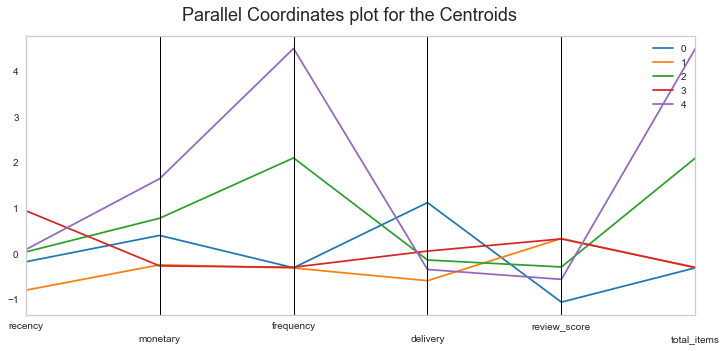

In [176]:
# Create a data frame containing our centroids
centers = pca.inverse_transform(kmeans.cluster_centers_)
centroids = pd.DataFrame(centers,
                          columns=rfm_log_scaled.columns)
centroids['cluster'] = centroids.index
# centroids
display_parallel_coordinates_centroids(centroids, 5)

We can distinguish 5 different groups of customers from the above graph:

* A cluster 0 (blue line) of customers who didn't spend much money but are quite satisfied about the service by giving good review score
* A cluster 1 (orange line) of customers who made a one time purchase a while ago, spent a fair bit of money but gave quite low review score as the delivery time was amongst the longest.
* A cluster 2 (green line) of customers who purchased more often than others for a fair bit of money. They gave quite low review score as the delivery time not quick enough for them. 
* A cluster 3 (red line) of customers who made a one time (quite low value) purchase but recently. They gave a good review score as they received their product quite quickly. 
* A cluster 4 (purple line) of customers who bought quite often & more products than the rest of the customers. They are the biggest spenders. Top customers.

In [184]:
# Liste des fonctions d'aggrégation
# func = ['mean']
# Regroupement des données
groups = X.groupby(['pred_cluster'])
groups
# Aggrégation des données par différentes fonctions
# overview = groups.agg(func)
# Affichage de la table de résumé
# overview

### Density Based Spatial Clustering of Applications with Noise (DBSCAN)

Density-based spatial clustering of applications with noise (DBSCAN) is a density-based clustering non-parametric algorithm: given a set of points in some space, it groups together points that are closely packed together (points with many nearby neighbors), marking as outliers points that lie alone in low-density regions (whose nearest neighbors are too far away). DBSCAN is one of the most common clustering algorithms.

In [204]:
# min_samples is selected based on our domain knowledge, 
# it's derived from the number of dimensions D and our data
db=DBSCAN(eps=0.5, min_samples=35).fit(X_reduced)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

In [205]:
df_rfm_log['pred_cluster_DBSCAN'] = labels

In [206]:
# set of clusters labels
set(labels)

{-1, 0, 1, 2, 3, 4}

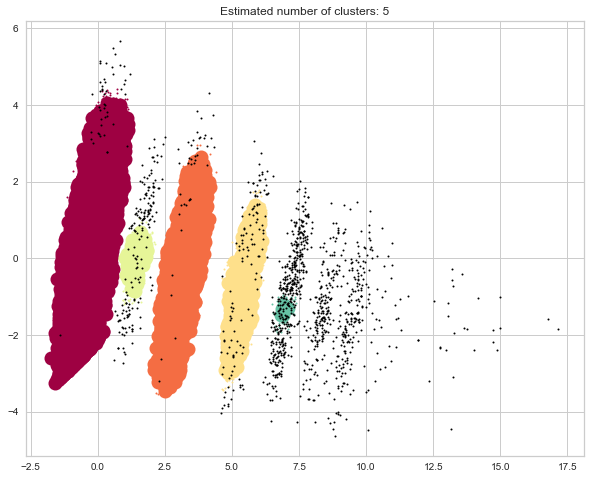

In [207]:
# Plot result
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = X_reduced[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)

    xy = X_reduced[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=2)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

In [208]:
import plotly.graph_objects as go
db=DBSCAN(eps=0.5, min_samples=20).fit(X_reduced)

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

#Even if we don't specify the number of cluster DBSCAN is good
# at detecting the number of clusters unlike k-means in which
# the number of clusters need to be specified. 
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
# add pred_cluster original df
rfm_log_scaled['pred_cluster_DBSCAN'] = labels
# set of clusters labels
set(labels)

#3d Scatter plot of clusters using DBSCAN
fig = px.scatter_3d(X_reduced, x= X_reduced[:,0], y= X_reduced[:,1],z = X_reduced[:,2],
color=rfm_log_scaled['pred_cluster_DBSCAN'], labels={'x':'Feature 1', 'y':'Feature 2','z':'Feature 3'} )

fig.update_traces(marker=dict(size=4,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
fig.show()

In [77]:
db=DBSCAN(eps=0.5, min_samples=20).fit(X_reduced)

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
#3d Scatter plot of clusters using DBSCAN
xy = X_reduced[class_member_mask & core_samples_mask]
fig = px.scatter_3d(xy, x= xy[:,0], y= xy[:,1],z = xy[:,2],
color=rfm_log_scaled['pred_cluster_DBSCAN'], labels={'x':'Feature 1', 'y':'Feature 2','z':'Feature 3'} )

fig.update_traces(marker=dict(size=6,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
fig.show()

1:3: E225 missing whitespace around operator
16:1: W293 blank line contains whitespace
17:1: E265 block comment should start with '# '
19:27: E251 unexpected spaces around keyword / parameter equals
19:32: E231 missing whitespace after ','
19:39: E251 unexpected spaces around keyword / parameter equals
19:44: E231 missing whitespace after ','
19:47: E231 missing whitespace after ','
19:49: E251 unexpected spaces around keyword / parameter equals
19:51: E251 unexpected spaces around keyword / parameter equals
19:56: E231 missing whitespace after ','
20:1: E128 continuation line under-indented for visual indent


ValueError: too many values to unpack (expected 3)

DBSCAN clustering algorithm is sensitive to the eps value we choose. The goal of the 'Knee method' is to find the average of distances for every point to its K nearest neighbors and select the distance at which maximum curvature or a sharp change happens. The value of K is set to be equal to minPoints.

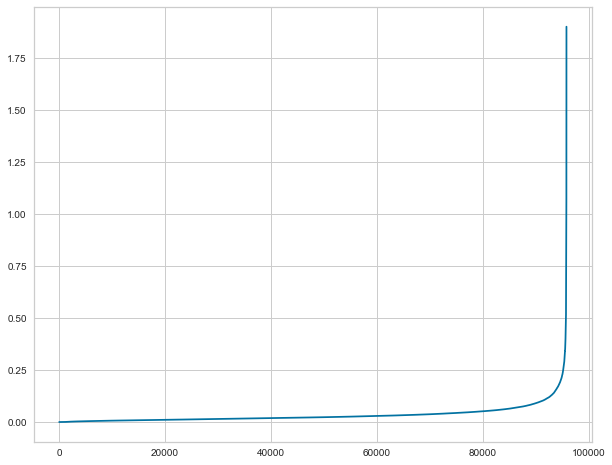

In [78]:
from sklearn.neighbors import NearestNeighbors
nearest_neighbors = NearestNeighbors(n_neighbors=5)
nearest_neighbors.fit(X_reduced)
distances, indices = nearest_neighbors.kneighbors(X_reduced)
distances = np.sort(distances, axis=0)[:, 1]
plt.plot(distances)
plt.show()

### TSNE 

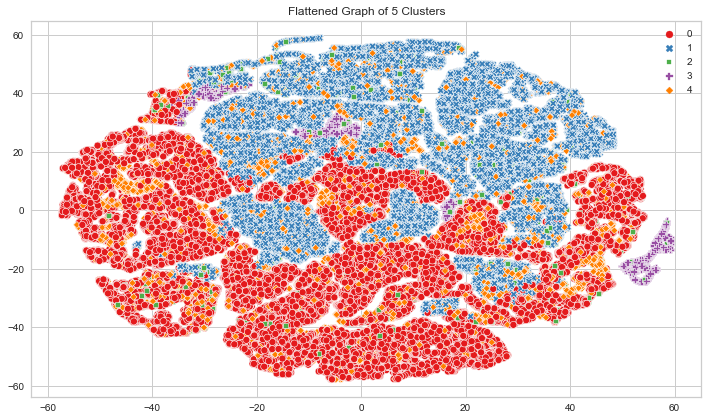

2:1: W293 blank line contains whitespace
3:39: E251 unexpected spaces around keyword / parameter equals
3:41: E251 unexpected spaces around keyword / parameter equals
3:71: E251 unexpected spaces around keyword / parameter equals
3:73: E251 unexpected spaces around keyword / parameter equals
5:1: W293 blank line contains whitespace
8:1: W293 blank line contains whitespace
10:35: E251 unexpected spaces around keyword / parameter equals
10:37: E251 unexpected spaces around keyword / parameter equals
11:1: W293 blank line contains whitespace
15:1: W293 blank line contains whitespace
18:36: E231 missing whitespace after ','
18:56: E231 missing whitespace after ','
18:80: E501 line too long (117 > 79 characters)
19:1: W293 blank line contains whitespace
22:1: E305 expected 2 blank lines after class or function definition, found 1


In [79]:
def kmeans(rfm_norm, clusters_number, df_rfm):
    
    kmeans = cluster.KMeans(n_clusters = clusters_number, random_state = 42)
    kmeans.fit(rfm_norm)
    
# Extract cluster labels
    cluster_labels = kmeans.labels_
        
    # Create a cluster label column in original dataset
    df_new = df_rfm.assign(Cluster = cluster_labels)
    
    # Initialise TSNE
    model = TSNE(n_components=2, perplexity=30.0, random_state=42)
    transformed = model.fit_transform(df_new)
    
    # Plot t-SNE
    plt.title('Flattened Graph of {} Clusters'.format(clusters_number))
    sns.scatterplot(x=transformed[:,0], y=transformed[:,1], hue=cluster_labels, style=cluster_labels, palette="Set1")
    
    return df_new

plt.figure(figsize=(10, 6))
# plt.subplot(1, 1)
# df_rfm_k4 = kmeans(rfm_norm, 4, df_rfm)
# plt.subplot(2, 1)
df_rfm_k5 = kmeans(rfm_norm, 5, df_rfm)
plt.tight_layout()

### Log Scale

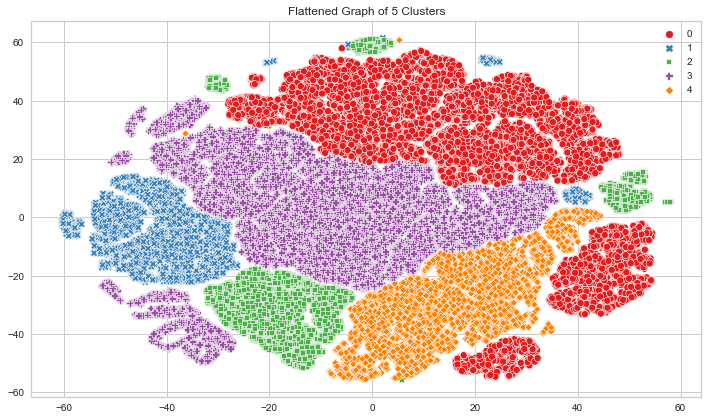

2:1: W293 blank line contains whitespace
3:39: E251 unexpected spaces around keyword / parameter equals
3:41: E251 unexpected spaces around keyword / parameter equals
3:71: E251 unexpected spaces around keyword / parameter equals
3:73: E251 unexpected spaces around keyword / parameter equals
5:1: W293 blank line contains whitespace
8:1: W293 blank line contains whitespace
10:40: E251 unexpected spaces around keyword / parameter equals
10:42: E251 unexpected spaces around keyword / parameter equals
11:1: W293 blank line contains whitespace
15:1: W293 blank line contains whitespace
18:36: E231 missing whitespace after ','
18:56: E231 missing whitespace after ','
18:80: E501 line too long (117 > 79 characters)
19:1: W293 blank line contains whitespace
22:1: E305 expected 2 blank lines after class or function definition, found 1


In [80]:
def kmeans(rfm_log_scaled, clusters_number, df_rfm_log):
    
    kmeans = cluster.KMeans(n_clusters = clusters_number, random_state = 42)
    kmeans.fit(rfm_log_scaled)
    
# Extract cluster labels
    cluster_labels = kmeans.labels_
        
    # Create a cluster label column in original dataset
    df_new1 = df_rfm_log.assign(Cluster = cluster_labels)
    
    # Initialise TSNE
    model = TSNE(n_components=2, perplexity=30.0, random_state=42)
    transformed = model.fit_transform(df_new1)
    
    # Plot t-SNE
    plt.title('Flattened Graph of {} Clusters'.format(clusters_number))
    sns.scatterplot(x=transformed[:,0], y=transformed[:,1], hue=cluster_labels, style=cluster_labels, palette="Set1")
    
    return df_new1

plt.figure(figsize=(10, 6))
# plt.subplot(1, 1)
# df_rfm_k4 = kmeans(rfm_log_scaled, 4, df_rfm_log)
# plt.subplot(2, 1)
df_rfm_k5 = kmeans(rfm_log_scaled, 5, df_rfm_log)
plt.tight_layout()

Clustering stability is a method for model selection in clustering, based on the principle that if we repeatedly perturb a data set, a good clustering algorithm should output similar partitions. In particular, it allows to select the correct number of clusters in an unlabeled data set.

### HDBSCAN

HDBSCAN - Hierarchical Density-Based Spatial Clustering of Applications with Noise. Performs DBSCAN over varying epsilon values and integrates the result to find a clustering that gives the best stability over epsilon. This allows HDBSCAN to find clusters of varying densities (unlike DBSCAN), and be more robust to parameter selection.

In [81]:
import hdbscan
clusterer = hdbscan.HDBSCAN(min_cluster_size=500, min_samples=20,
                            metric='euclidean')
clusterer.fit(rfm_log_scaled[['recency', 'frequency', 'monetary', 'delivery', 'review_score', 'total_items']])
rfm_log_scaled['Cluster'] = pd.Series(clusterer.labels_, index=rfm_log_scaled.index)

rfm_log_scaled.head(5)

,recency,monetary,frequency,delivery,review_score,total_items,pred_cluster_DBSCAN,Cluster
0,0.523993,0.057220,-0.310459,0.425704,-2.678437,-0.303167,0,2
1,0.897256,-0.600048,-0.310459,-0.103219,0.045425,-0.303167,0,8
2,1.203857,0.718340,-0.310459,-0.906218,0.587413,-0.303167,0,12
3,0.814168,0.611648,-0.310459,1.570469,0.587413,-0.303167,0,-1
4,-0.165394,-0.029181,-0.310459,0.183384,0.045425,-0.303167,0,8


4:80: E501 line too long (110 > 79 characters)
5:80: E501 line too long (84 > 79 characters)


In [82]:
len(rfm_log_scaled['Cluster'].unique())-1

19

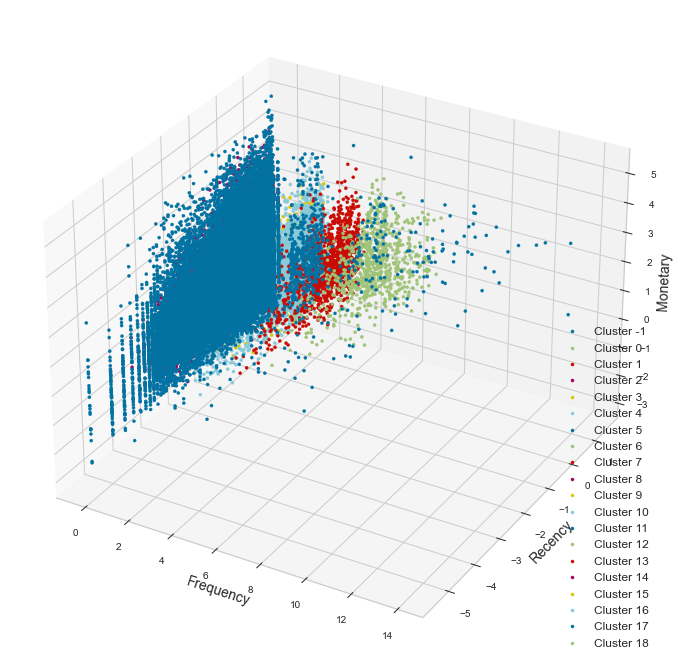

2:1: E265 block comment should start with '# '
3:29: E231 missing whitespace after ','
6:18: E231 missing whitespace after ','
8:22: E127 continuation line over-indented for visual indent
9:22: E127 continuation line over-indented for visual indent
10:22: E127 continuation line over-indented for visual indent
10:27: E251 unexpected spaces around keyword / parameter equals
10:29: E251 unexpected spaces around keyword / parameter equals
11:22: E127 continuation line over-indented for visual indent


In [83]:
from mpl_toolkits.mplot3d import Axes3D
#import matplotlib.colors as mcolors
fig = plt.figure(figsize=(18,12))
dx = fig.add_subplot(111, projection='3d')

for i in range(-1,len(rfm_log_scaled['Cluster'].unique())-1):
    dx.scatter(rfm_log_scaled[rfm_log_scaled.Cluster == i].frequency,
                     rfm_log_scaled[rfm_log_scaled.Cluster == i].recency,
                     rfm_log_scaled[rfm_log_scaled.Cluster == i].monetary,
                     label = 'Cluster ' + str(i),
                     s=10, alpha=1.0)
dx.set_xlabel('Frequency', fontsize=14)
dx.set_ylabel('Recency', fontsize=14)
dx.set_zlabel('Monetary', fontsize=14)
dx.legend(fontsize=12)
plt.show()

In [84]:
pd.Series(clusterer.labels_).value_counts()

-1     19909
 8     16480
 18    10399
 2      7233
 6      6541
 4      5715
 14     3570
 13     3248
 12     2961
 15     2758
 11     2528
 5      2194
 16     2165
 10     2071
 9      1817
 17     1649
 3      1403
 1      1257
 7      1111
 0       801
dtype: int64

# --------------------------------

Here is the Silhouette analysis done on the above plots to select an optimal value for n_clusters.

The value of n_clusters as 4 and 5 looks to be suboptimal for the given data due to the following reasons:<br>
Presence of clusters with below-average silhouette scores <br>
Wide fluctuations in the size of the silhouette plots.

The value of 2 and 3 for n_clusters looks to be the optimal one. The silhouette score for each cluster is above average silhouette scores. Also, the fluctuation in size is similar. The thickness of the silhouette plot representing each cluster also is a deciding point. For the plot with n_cluster 3 (top right), the thickness is more uniform than the plot with n_cluster as 2 (top left) with one cluster thickness much more than the other. Thus, one can select the optimal number of clusters as 3.


### DBSCAN

In [85]:
# Instantiate k-means and dbscan algorithms
kmeans = KMeans(n_clusters=5)
dbscan = DBSCAN(eps=0.3)

# Fit the algorithms to the features
kmeans.fit(rfm_log_scaled)
dbscan.fit(rfm_log_scaled)

# Compute the silhouette scores for each algorithm
kmeans_silhouette = silhouette_score(
    rfm_log_scaled, kmeans.labels_).round(2)
dbscan_silhouette = silhouette_score(
    rfm_log_scaled, dbscan.labels_).round(2)

In [86]:
kmeans_silhouette

0.48

In [87]:
dbscan_silhouette

-0.04

KeyError: 5

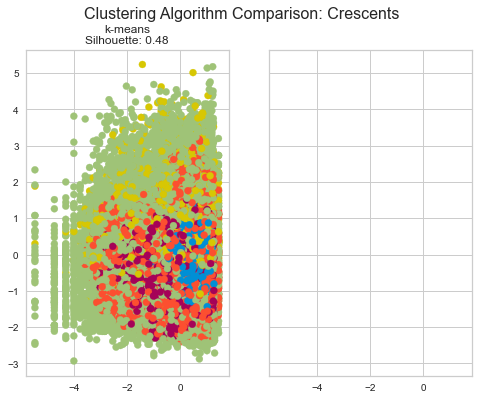

ValueError: too many values to unpack (expected 3)

In [88]:
# Plot the data and cluster silhouette comparison
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 6), sharex=True, sharey=True)

fig.suptitle(f"Clustering Algorithm Comparison: Crescents", fontsize=16)
fte_colors = {0: "#008fd5", 1: "#fc4f30", 2: "g", 3:"m", 4:"y"}
# The k-means plot
km_colors = [fte_colors[label] for label in kmeans.labels_]
ax1.scatter(rfm_log_scaled.iloc[:, 0], rfm_log_scaled.iloc[:, 1], c=km_colors)
ax1.set_title(f"k-means\nSilhouette: {kmeans_silhouette}")

# The dbscan plot
db_colors = [fte_colors[label] for label in dbscan.labels_]
ax2.scatter(rfm_log_scaled.iloc[:, 0], rfm_log_scaled.iloc[:, 1], c=db_colors)
ax2.set_title( "DBSCAN\nSilhouette: {dbscan_silhouette}")
plt.show()

In [ ]:
ari_kmeans = adjusted_rand_score(true_labels, kmeans.labels_)
ari_dbscan = adjusted_rand_score(true_labels, dbscan.labels_)

In [ ]:
round(ari_kmeans, 2)

In [ ]:
round(ari_dbscan, 2)